In [ ]:
from google.colab import files
uploaded = files.upload()

Saving India.wav to India.wav


In [ ]:
import librosa
import io    
audio_data = 'India.wav'                                                    
#audio_data = 'FireIgnite.wav'                   # path of the audio file

x,sr = librosa.load(audio_data)  # Returns an audio time series as a numpy array with a default sampling rate(sr) of 22KHZ

In [ ]:
print("Sample rate  :", sr)
print("Signal Length:", len(x))
print("Duration     :", len(x)/sr, "seconds")

Sample rate  : 22050
Signal Length: 1786176
Duration     : 81.00571428571429 seconds


In [ ]:
librosa.get_duration(x)

81.00571428571429

In [ ]:
import IPython.display
IPython.display.Audio(audio_data)  

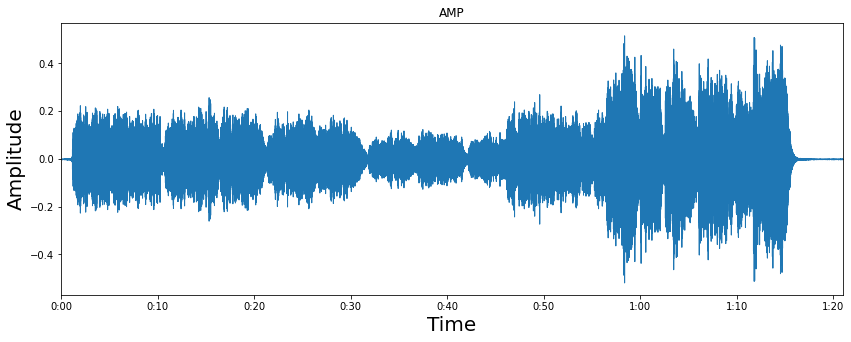

In [ ]:
#######  Waveform visualization   ################# 
%matplotlib inline
import matplotlib.pyplot as plt                  
import librosa.display

plt.figure(figsize=(14, 5))
plt.title("AMP")
plt.xlabel("Time", fontsize=20)
plt.ylabel("Amplitude", fontsize=20)
#plt.figure(figsize=(14, 5))                      #  Waveform visualization of th
librosa.display.waveplot(x, sr=sr,max_points=82)    

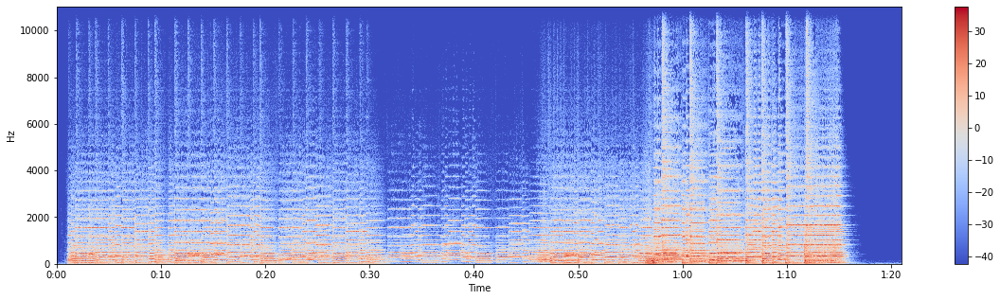

In [ ]:
#######  Spectrogram   ################# 
X = librosa.stft(x)   # x:numpy array,.stft() converts data into short term Fourier transfor so that we can know amplitude of given frequency at given time
Xdb = librosa.amplitude_to_db(abs(X))            # converting into energy levels(dB)

plt.figure(figsize=(20, 5))                      # spectrum of frequencies of a signal as it varies with time to see how energy levels (dB) vary over time.
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz') # .specshow is used to display a spectrogram.
plt.colorbar()     

In [ ]:
onset_frames = librosa.onset.onset_detect(x, sr=sr)
print(onset_frames)


[  37   47   65   84  135  156  163  190  216  272  327  354  368  380
  408  463  490  518  535  544  572  599  612  627  639  652  679  704
  761  801  814  841  921  976 1016 1032 1062 1086 1142 1197 1254 1283
 1369 1385 1399 1412 1419 1454 1466 1481 1494 1502 1510 1561 1590 1605
 1620 1627 1652 1674 1680 1689 1703 1708 1722 1767 1814 1842 1852 1867
 1895 1998 2007 2030 2041 2055 2068 2082 2096 2125 2139 2154 2181 2195
 2208 2237 2249 2268 2295 2309 2325 2352 2383 2408 2414 2450 2465 2471
 2484 2501 2585 2587 2600 2615 2628 2695 2726 2830 2840 2847 2856 2883
 2903 2913 2939 2954 2960 2984 3012 3089 3096]


In [ ]:
onset_times = librosa.frames_to_time(onset_frames, sr=sr)
print(onset_times)

[ 0.85913832  1.09133787  1.50929705  1.95047619  3.13469388  3.62231293
  3.78485261  4.41179138  5.0155102   6.31582766  7.59292517  8.21986395
  8.54494331  8.82358277  9.4737415  10.750839   11.37777778 12.02793651
 12.42267574 12.63165533 13.28181406 13.90875283 14.21061224 14.55891156
 14.83755102 15.13941043 15.76634921 16.34684807 17.67038549 18.59918367
 18.90104308 19.52798186 21.38557823 22.66267574 23.59147392 23.9629932
 24.65959184 25.21687075 26.51718821 27.79428571 29.11782313 29.79120181
 31.78811791 32.15963719 32.48471655 32.78657596 32.94911565 33.76181406
 34.04045351 34.38875283 34.69061224 34.87637188 35.06213152 36.24634921
 36.91972789 37.26802721 37.61632653 37.77886621 38.35936508 38.87020408
 39.00952381 39.2185034  39.54358277 39.65968254 39.9847619  41.02965986
 42.12099773 42.77115646 43.00335601 43.35165533 44.00181406 46.39346939
 46.60244898 47.13650794 47.39192744 47.7170068  48.01886621 48.34394558
 48.66902494 49.34240363 49.66748299 50.01578231 50.

In [ ]:
onset_samples = librosa.frames_to_samples(onset_frames)
print(onset_samples)

[  18944   24064   33280   43008   69120   79872   83456   97280  110592
  139264  167424  181248  188416  194560  208896  237056  250880  265216
  273920  278528  292864  306688  313344  321024  327168  333824  347648
  360448  389632  410112  416768  430592  471552  499712  520192  528384
  543744  556032  584704  612864  642048  656896  700928  709120  716288
  722944  726528  744448  750592  758272  764928  769024  773120  799232
  814080  821760  829440  833024  845824  857088  860160  864768  871936
  874496  881664  904704  928768  943104  948224  955904  970240 1022976
 1027584 1039360 1044992 1052160 1058816 1065984 1073152 1088000 1095168
 1102848 1116672 1123840 1130496 1145344 1151488 1161216 1175040 1182208
 1190400 1204224 1220096 1232896 1235968 1254400 1262080 1265152 1271808
 1280512 1323520 1324544 1331200 1338880 1345536 1379840 1395712 1448960
 1454080 1457664 1462272 1476096 1486336 1491456 1504768 1512448 1515520
 1527808 1542144 1581568 1585152]


In [ ]:
# Use the `length` parameter so the click track is the same length as the original signal
clicks = librosa.clicks(times=onset_times, length=len(x))

import IPython.display as ipd
# Play the click track "added to" the original signal
ipd.Audio(x+clicks, rate=sr)

In [ ]:
zero_crossings = librosa.zero_crossings(x, pad=False)

zero_crossings.shape    # That computed a binary mask where True indicates the presence of a zero crossing. 

(1786176,)

In [ ]:
print(sum(zero_crossings)) # To find the total number of zero crossings, use sum:

123300


In [ ]:
zcrs = librosa.feature.zero_crossing_rate(x) # To find the zero-crossing rate over time, use zero_crossing_rate:
print(zcrs.shape)

(1, 3489)


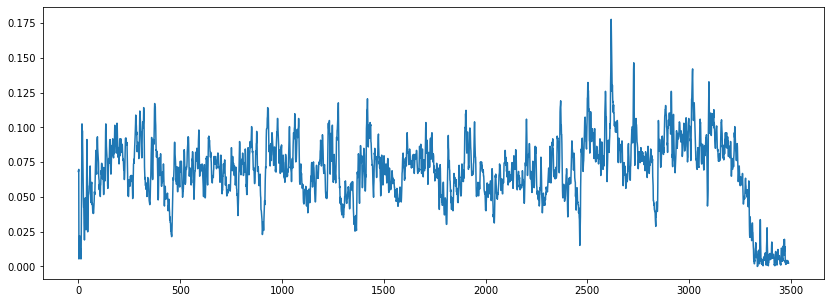

In [ ]:
plt.figure(figsize=(14, 5))        # Plot the zero-crossing rate:
plt.plot(zcrs[0])

In [ ]:
# Compute the short-time energy using a list comprehension
hop_length = 256
frame_length = 512

energy = numpy.array([
    sum(abs(x[i:i+frame_length]**2))
    for i in range(0, len(x), hop_length)
])

energy.shape

In [ ]:
# Compute the RMSE using librosa.feature.rmse
rmse = librosa.feature.rmse(x, frame_length=frame_length, hop_length=hop_length, center=True)

rmse.shape

In [ ]:
rmse = rmse[0]

# Plot both the energy and RMSE along with the waveform
frames = range(len(energy))
t = librosa.frames_to_time(frames, sr=sr, hop_length=hop_length)

Conversion of mp3 to .wav format

In [ ]:
from os import path


In [ ]:
!pip install ffmpeg
!pip install pydub

In [ ]:
from pydub import AudioSegment

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving India.mp3 to India.mp3


In [ ]:
sound = AudioSegment.from_mp3("India.mp3")


In [ ]:

sound.export("check.wav", format="wav")

<_io.BufferedRandom name='check.wav'>